# Multiscale Analisys of images

The goal of this laboratory is to analyze different schemes allowing a multiscale analysis where frequency components are progressively extracted from images. We will analyze in particular pyramidal decomposition and the wavelet transform. 


## 1 Lab configuration

As usual, let us first load the necessary packages for this laboratory. 

In [8]:
!pip install pillow==9.0.1 numpy==1.21.5 scikit-image==0.19.2 albumentations==1.1.0 imgaug==0.4.0 datascience==0.17.0 coveralls==3.3.1 matplotlib==3.5.1 pywavelets==1.2.0  plotly==5.6.0


It may be useful to have an efficient way to transfer data from your google drive to colaboratory. This can be done by mounting your google drive in the colaboratory environment. 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Let us copy the needed images for the lab. 

In [ ]:
!wget "https://drive.google.com/uc?id=1TFLn46IKEp4rfRpE4cEZUKkaoGgG7C8Q" -O "lena.bmp"

### 1.1 Initialization

Let us import the necessary libraries and create some useful functions for visualization. 

In [9]:
import numpy as np

import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

import skimage.filters as skfi
import skimage.transform as sktf
import skimage.io as skio

import pywt 

import plotly.express as px
import plotly.graph_objects as go


def display_image(img_in, title='', size=None):
  img = img_in.astype(np.double)
  img = img - np.min(img)
  img = img / np.max(img)
  
  plt.gray()
  h = plt.imshow(img, interpolation='none')
  if size:
    dpi = h.figure.get_dpi()/size
    h.figure.set_figwidth(img.shape[1] / dpi)
    h.figure.set_figheight(img.shape[0] / dpi)
    h.figure.canvas.resize(img.shape[1] + 1, img.shape[0] + 1)
    h.axes.set_position([0, 0, 1, 1])
    h.axes.set_xlim(-1, img.shape[1])
    h.axes.set_ylim(img.shape[0], -1)
  plt.grid(False)
  plt.title(title)  
  plt.show()


def display_images(imgs, columns=None, rows=None, size=None, path=None, title=''):  

  C = len(imgs)
  
  if columns==None:
    columns = int(C/2)
    rows = 2

  pos  = range(1,columns*rows + 1)
  fig = plt.figure(1)
  fig.tight_layout()
  k=0
  for c in range(columns):
    for r in range(rows):
      img = imgs[k]
      ax = fig.add_subplot(rows,columns,pos[k])
      h = ax.imshow(img, interpolation='none')
      if size:
        dpi = h.figure.get_dpi()/size
        h.figure.set_figwidth(img.shape[1] / dpi)
        h.figure.set_figheight(img.shape[0] / dpi)
        h.figure.canvas.resize(img.shape[1] + 1, img.shape[0] + 1)
        #h.axes.set_position([0, 0, 1, 1])
        h.axes.set_xlim(-1, img.shape[1])
        h.axes.set_ylim(img.shape[0], -1)
  
      plt.grid(False)
      plt.axis('off')
      k = k+1

  #ax.figure.set_size_inches(6*columns*H/100, 6*rows*H/100)
  if path:
    plt.savefig(path)
    
  plt.show()

def display_ft(ft, title=''):
  N = ft.shape[0]
  x = np.linspace(-0.5, 0.5, N)
  y = np.linspace(-0.5, 0.5, N)
  X, Y = np.meshgrid(x, y)
  fig = go.Figure(data=[go.Surface(z=ft,x=X,y=Y)])
  fig.update_layout(title=title)
  fig.update_layout(scene = dict(xaxis_title='Fx', yaxis_title='Fy', zaxis_title='FT'))
  fig.show()

def display_dft(ft, title=''):
  fig = go.Figure(data=[go.Surface(z=ft)])
  fig.update_layout(title=title)
  fig.update_layout(scene = dict(xaxis_title='k', yaxis_title='l', zaxis_title='DFT'))
  fig.show()

def display_wavelet_dec(coeffs, size=1, title=''):

  arr, coeff_slices = pywt.coeffs_to_array(coeffs)

  arr_norm = arr

  # Normalize low band separately (for representation purposes)
  arr_norm[coeff_slices[0]] = arr_norm[coeff_slices[0]] - np.min(arr_norm[coeff_slices[0]])
  arr_norm[coeff_slices[0]] = (arr_norm[coeff_slices[0]] / (np.max(arr_norm[coeff_slices[0]]) + 1e-50))
  lb = arr_norm[coeff_slices[0]].copy()
  arr_norm[coeff_slices[0]] = 0

  # Normalize coeffs
  arr_norm = arr_norm - np.min(arr_norm)
  arr_norm = (arr_norm / (np.max(arr_norm) + 1e-50)) - 0.5
  arr_norm = arr_norm.clip(-0.1,0.1)*5 + 0.5 
  arr_norm[coeff_slices[0]] = lb

  display_image(arr_norm, size=size, title=title)


Select an image of your choice (from the internet or your personal photo collection). We are going to analyze its frequency content. So try to select an image that areas with different frequency content, that is some areas with low frequencies, others with high frequencies and others with intermediate frequencies. Also make sure you image size is reasonable and corresponds to a power of two either 512x512 or 1024x1024 (if necessary you may have to downsample your image).

Read it so that you can process it. For simplicity we want to work with gray scale images so make sure you use "as_gray=True" when reading it to colab and that you normalize them so gray values go from 0.0 to 1.0

In [10]:
# Read image
img = skio.imread('lena.bmp', as_gray=True)

# Resize to 256x256 (already converts to [0,1])
img = sktf.resize(img,(256,256))

# Make sure gray values go from [0,1]
#img = img.astype(np.double)/255

# Print max and min values
print('Minimum value = ', np.min(img), '; Maximum value = ', np.max(img))
print('img shape = ', img.shape)

Minimum value =  0.10873952155257571 ; Maximum value =  0.9154378535841878
img shape =  (256, 256)


In [11]:
# Read image
img2 = skio.imread('test2.bmp', as_gray=True)

# Resize to 256x256 (already converts to [0,1])
img2 = sktf.resize(img2,(256,256))

# Make sure gray values go from [0,1]
#img = img.astype(np.double)/255

# Print max and min values
print('Minimum value = ', np.min(img2), '; Maximum value = ', np.max(img2))
print('img shape = ', img2.shape)

Minimum value =  0.10700670445786654 ; Maximum value =  0.8637505992772782
img shape =  (256, 256)


## 2 Pyramidal multiscale analysis



Using Gaussian filters, a multiscale analysis of images can be obtained with the following scheme: 
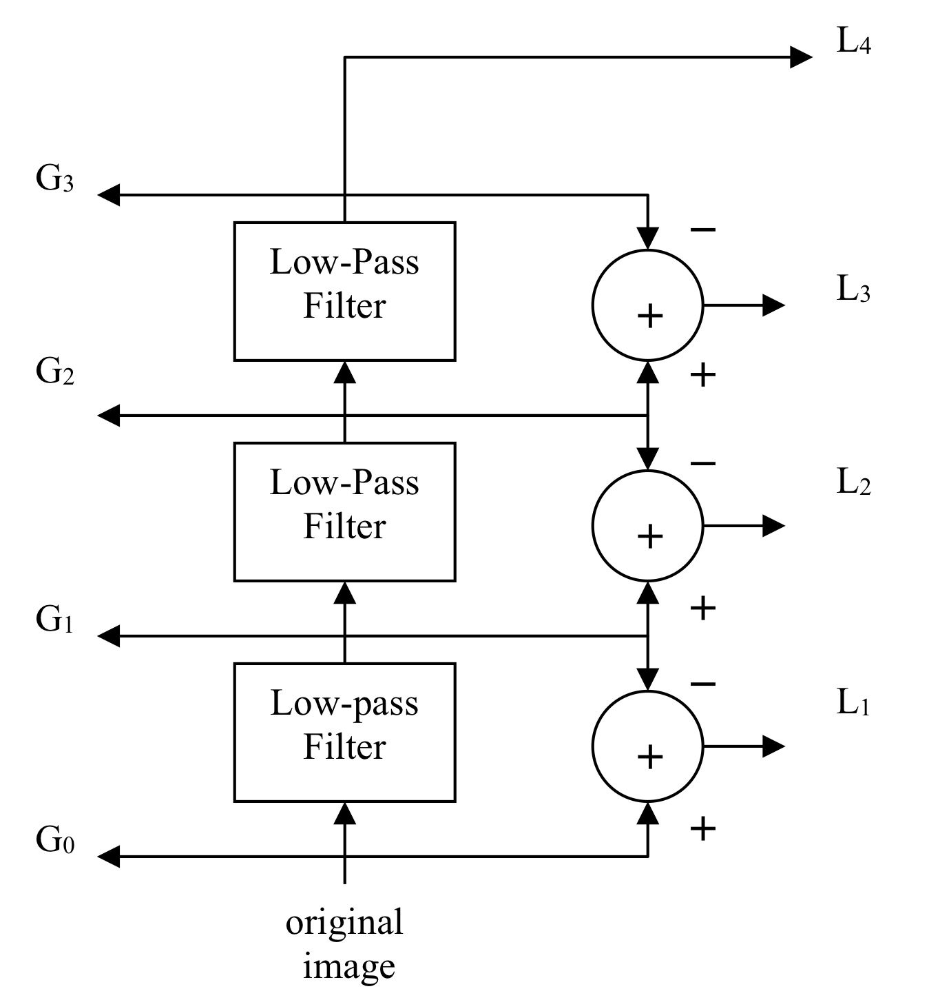

$G_n$ images are called 'gaussians' because they are usually obtained with Gaussian filters. $L_n$ images are called 'laplacians' because they frequency spectrum is the complement of a Gaussian. Note that they are not really obtained with laplacian filters. They are computed by a difference between Gaussians:

\begin{equation}
L_n = G_{n-1} - G_n \tag{1}
\end{equation}

From equation (1), one can easily show that:

\begin{equation}
G_0 = G_1 + L_1 = (G_2 + L_2) + L_1 = \cdots = L_N + L_{N-1} + \cdots + L_1 \tag{2}
\end{equation}

As can be seen, the original image can always be reconstructed from the set of $L_n$ images.

We will implement the decomposision defined by equation (1) using Gaussian filters. Let us review first how we can use Gaussian and Laplacian impulse responses to filter images.








### 2.1 Linear filters

Let us test filtering images with a low-pass (gaussian) and high-pass (laplacian) filters. First we generate the impulse response of a gaussian filter and visualize the frequency response:



[[0.00296902 0.01330621 0.02193823 0.01330621 0.00296902]
 [0.01330621 0.0596343  0.09832033 0.0596343  0.01330621]
 [0.02193823 0.09832033 0.16210282 0.09832033 0.02193823]
 [0.01330621 0.0596343  0.09832033 0.0596343  0.01330621]
 [0.00296902 0.01330621 0.02193823 0.01330621 0.00296902]]


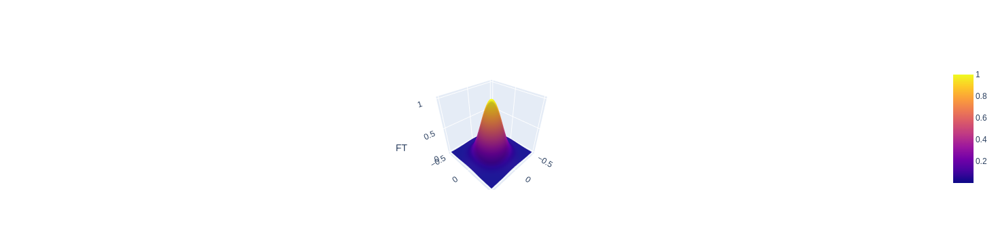

In [12]:
def gaussian_kernel(size=5,sigma=1.0):
  a = np.zeros((size, size))
  a[int(np.floor(size/2)),int(np.floor(size/2))] = 1
  h = skfi.gaussian(a, sigma=sigma, mode='constant', cval=0)
  return h/np.sum(h)

# Define a gaussian kernel (size=5 and sigma=1)
h_gau = gaussian_kernel(size=5,sigma=1)
print(h_gau)

# Visualize its frequency response
N = 256
H_GAU = np.abs(np.fft.fftshift(np.fft.fft2(h_gau,(N,N))))
display_ft(H_GAU)

And repeat the process for the laplacian filter:

[[ 0.  1.  0.]
 [ 1. -4.  1.]
 [ 0.  1.  0.]]


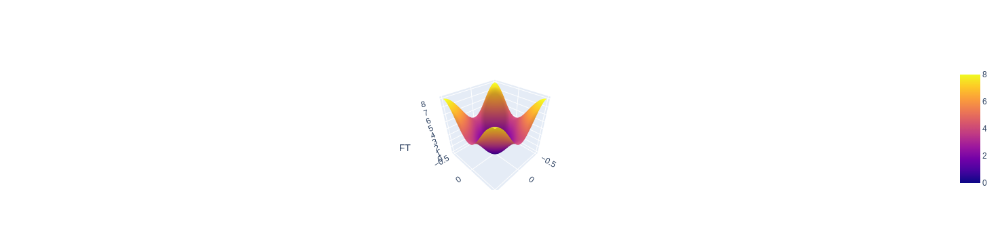

In [13]:
def laplace_kernel(alpha=0.0):
  h = np.zeros((3, 3))
  h1    = alpha/(alpha+1); h2 = (1-alpha)/(alpha+1);
  h[0,:] = [h1,h2,h1]
  h[1,:] = [h2, -4/(alpha+1), h2]
  h[2,:] = [h1,h2,h1]
  return h

# Define a laplacian kernel
h_lap = laplace_kernel()
print(h_lap)

# Visualize its frequency response
N = 256
H_LAP = np.abs(np.fft.fftshift(np.fft.fft2(h_lap,(N,N))))
display_ft(H_LAP)


To analyze the filtering results on the input image, we will use the convolution operator. Please note that the convolution of a sequence of length $L_1$ with another sequence of length $L_2$ creates e sequence of length $L_1 + L_2 - 1$. For example, the convolution of the input image of size $256x256$ with the impulse response h_gau of size $5x5$ creates an image of size $260x260$. But in many circumstances, we want the output image to be of the same size as the input image. In the command convolve2d(original_image, impulse_response, mode='same'), the parameter 'same' indicates that the output image has to be cut to have the same size as the original.


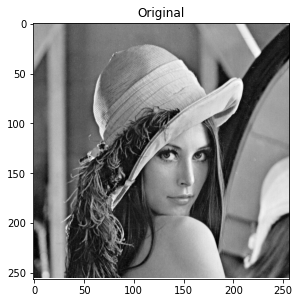

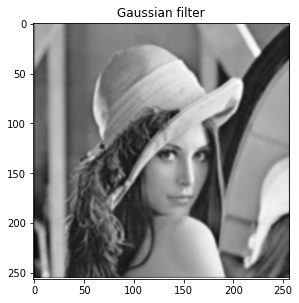

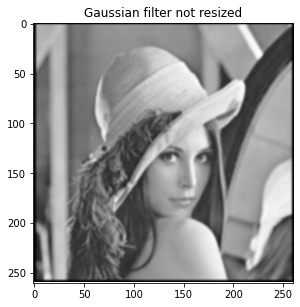

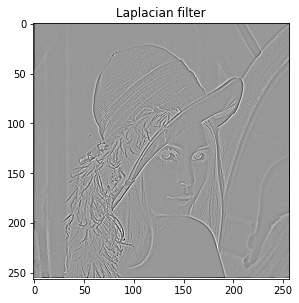

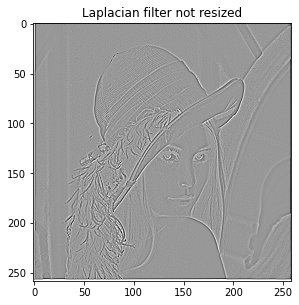

In [14]:
import scipy

img_gau = scipy.signal.convolve2d(img,h_gau,mode='same')
img_lap = scipy.signal.convolve2d(img,h_lap,mode='same')

img_gau_no_same = scipy.signal.convolve2d(img,h_gau)
img_lap_no_same = scipy.signal.convolve2d(img,h_lap)

display_image(img,size=1, title='Original')
display_image(img_gau,size=1, title='Gaussian filter')
display_image(img_gau_no_same,size=1, title='Gaussian filter not resized')
display_image(img_lap,size=1, title='Laplacian filter')
display_image(img_lap_no_same,size=1, title='Laplacian filter not resized')


In [18]:
img_gau2 = scipy.signal.convolve2d(img2,h_gau,mode='same')
img_lap2 = scipy.signal.convolve2d(img2,h_lap,mode='same')

img_gau_no_same2 = scipy.signal.convolve2d(img2,h_gau)
img_lap_no_same2 = scipy.signal.convolve2d(img2,h_lap)


What is the mean value of the filtered images? Note that the function "display_image()" normalizes the visualization of the image between its minimum (always black) and maximum (always white) values.

In [19]:
print('mean value original image = ', np.mean(img))
print('mean value gaussian filtered image = ', np.mean(img_gau))
print('mean value laplacian filtered image = ', np.mean(img_lap))
print('mean value gaussian filtered image not resized = ', np.mean(img_gau_no_same))
print('mean value laplacian filtered image not resized = ', np.mean(img_lap_no_same))

mean value original image =  0.48647223549714086
mean value gaussian filtered image =  0.4838869117327858
mean value laplacian filtered image =  -0.007328927864577972
mean value gaussian filtered image not resized =  0.4716190003778198
mean value laplacian filtered image not resized =  4.386585173313145e-19


In [20]:
print('mean value original image = ', np.mean(img2))
print('mean value gaussian filtered image = ', np.mean(img_gau2))
print('mean value laplacian filtered image = ', np.mean(img_lap2))
print('mean value gaussian filtered image not resized = ', np.mean(img_gau_no_same2))
print('mean value laplacian filtered image not resized = ', np.mean(img_lap_no_same2))

mean value original image =  0.6182169656828872
mean value gaussian filtered image =  0.614834685919177
mean value laplacian filtered image =  -0.009588203452734522
mean value gaussian filtered image not resized =  0.5993412287425102
mean value laplacian filtered image not resized =  1.534470859105739e-19


<font color='purple'>Q1. Comment and justify the visual content observed in the filtered images and the modification of the mean value of the images. How do these results about mean values change if you remove the ‘same’ parameter in the convolution. Try to relate the change of mean values to a specific feature of the frequency response or of the impulse response as well as the padding done outside the image to compute the convolution:</font>

---
<font color='red'>Q1. Answer: With the Gaussian filter, we smooth out the contrasts between different shades of gray by eliminating high frequencies. Therefore, most pixel values will not change or will change slightly, so we expect the mean not to change much. The mean is slightly lower because the edges are slightly diminished.

<font color='red'>The Laplacian filter only retains the edges, which are a very small part of the image. Since the other values are 0, it's normal for the mean to approach this value.

<font color='red'>If we remove the same, the means after applying the filters tend even more toward 0 because we have more pixels with value 0 (the pixels that make up the "frame" of the image) due to zero-padding during convolution.

<font color='red'>Another more mathematical explanation would be that the mean translates to the coefficient (0,0) in frequency. At this point, the output of the Gaussian filter is 1, and that of the Laplacian filter is 0. If instead, we look at the impulse response, we can also see that the sum of coefficients of the Gaussian filter is 1 and therefore preserves the value of the initial image. Conversely, the sum of the Laplacian filter is 0, so it's logical that the total sum of the filter is 0.

</font> 

High-pass filtering can also be achieved through a difference with a low-pass filter: 

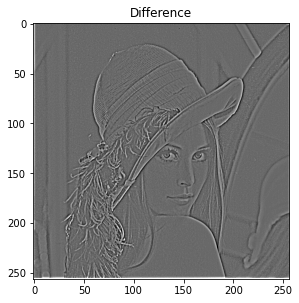

mean value difference image =  0.0025853237643549635


In [22]:
img_low = img_gau
img_high = img - img_low
display_image(img_high, size=1, title='Difference')
print('mean value difference image = ', np.mean(img_high))

<font color='purple'>Q2. What is the equivalent impulse response of the filter? Can you compute it and visualize the corresponding filter frequency response? </font>

---
<font color='red'>Q2. Answer: To obtain the complementary frequencies, we need to subtract the frequencies of the Gaussian filter from 1. If we convert this to the impulse response, it's equivalent to subtracting the impulse response of the filter from a delta. In the code below, we have reproduced this, and we can observe how we obtain the exact complementary filter.</font> 

[[-0.00296902 -0.01330621 -0.02193823 -0.01330621 -0.00296902]
 [-0.01330621 -0.0596343  -0.09832033 -0.0596343  -0.01330621]
 [-0.02193823 -0.09832033  0.83789718 -0.09832033 -0.02193823]
 [-0.01330621 -0.0596343  -0.09832033 -0.0596343  -0.01330621]
 [-0.00296902 -0.01330621 -0.02193823 -0.01330621 -0.00296902]]


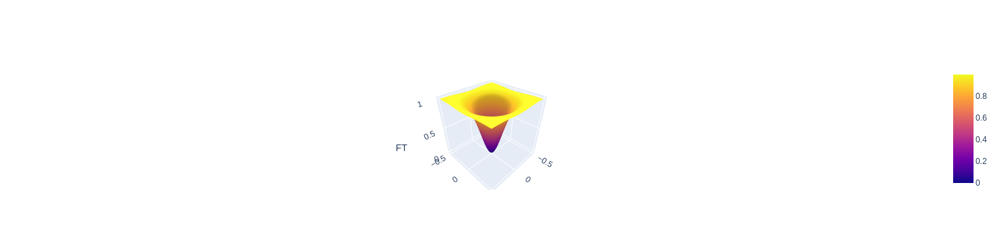

In [25]:
delta = np.zeros((5,5))
delta[2,2] = 1
h_inv_gau = delta - h_gau

print(h_inv_gau)

# Visualize its frequency response
N = 256
H_INV_GAU = np.abs(np.fft.fftshift(np.fft.fft2(h_inv_gau,(N,N))))
display_ft(H_INV_GAU)

The expression:
\begin{equation}
    img = img\_low + img\_high \tag{3}
\end{equation}

can be considered as a frequency decomposition of the original image. This equation is the core of the multiscale decomposition  studied in this section. 


### 2.2 Decomposition

Let us implement the decomposition defined by equation (1). We will use Gaussian filters as low-pass filters and define a structure with four levels as in the figure at the beginning of section 2. The result will be store in vector $g$ (with the four $G_0$, $G_1$, $G_2$ and $G_4$ images) and $l$ (with images $L_1$, $L_2$, $L_3$ and $L_4$):

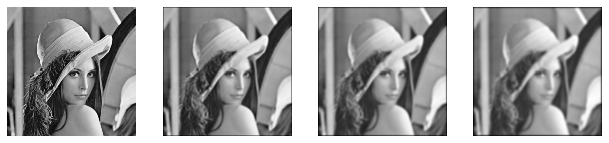

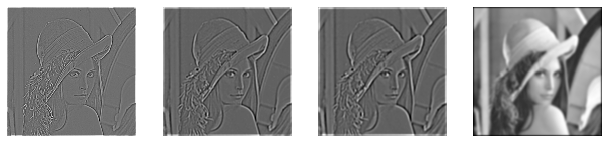

In [26]:
h = gaussian_kernel(size=5,sigma=1.5)
g = []
l = []
levels = 4

x = img
for i in range(levels):
  if i==0:
    g.append(x)
  else:
    x = scipy.signal.convolve2d(g[i-1],h,mode='same')
    g.append(x)
    l.append(g[i-1] - g[i])
l.append(g[i])

display_images(g,columns=4,rows=1,size=3)
display_images(l,columns=4,rows=1,size=3)

Let us compute that the reconstruction is correct:


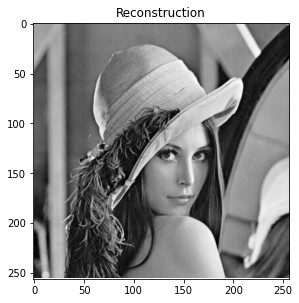

In [27]:
recons = l[3] + l[2] + l[1] + l[0]
display_image(recons,title='Reconstruction',size=1)

Finally, let us compte the reconstruction error (and the PSNR):


In [28]:
mse = np.mean(np.square(img - recons),axis=None)
psnr = -10*np.log10(mse+1e-100)
print('MSE = ', mse)
print('PSNR = ', psnr, 'dB')

MSE =  1.4693679385278594e-38
PSNR =  378.32869440653576 dB


<font color='purple'>Q3. Report the value of the PSNR. Is it what was expected? (remember that a computer has a limited number of bits to represent real numbers. So, extremely small rounding errors may occur): </font>

---
<font color='red'>Q3. Answer: There is practically no error since the MSE is 0. The PSNR is very high, indicating that there is also no noise. This is the expected outcome because during filtering, we simply separated the high frequencies but never eliminated them. Therefore, when we recombine them, it's expected that the image will be identical to the original.

</font> 

<font color='purple'>Q4. How can you explain that iterating the same filter, the resulting Gaussian images are increasingly low-pass?  Hint: use function convolve2d() and display_fft() to compute the frequency response of the filters (h_gau*h_gau) and (h_gau*h_gau*h_gaus) and compare them with h_gau. </font>

---
<font color='red'>Q4. Answer: As we can verify in the code below, each time we convolve the filter with itself, it becomes smaller. As it becomes smaller, it captures only the low frequencies of the frequencies that we were previously preserving. That is, it becomes an even lower-pass filter.
</font> 

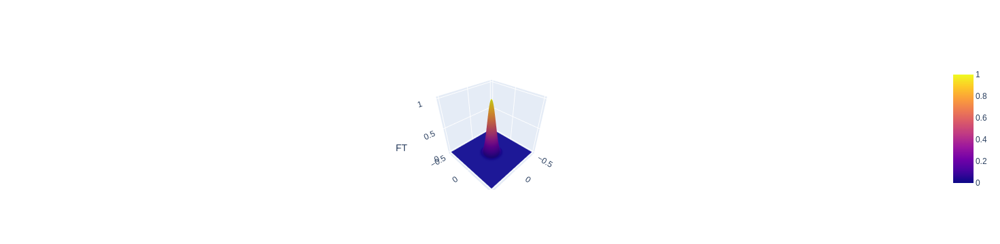

In [31]:
N = 256
H = np.abs(np.fft.fftshift(np.fft.fft2(h,(N,N))))

H_DEF = H**4
display_ft(H_DEF)

### 2.3 Subsampling

Subsampling the output of each Gaussian filter leads to the following scheme: 

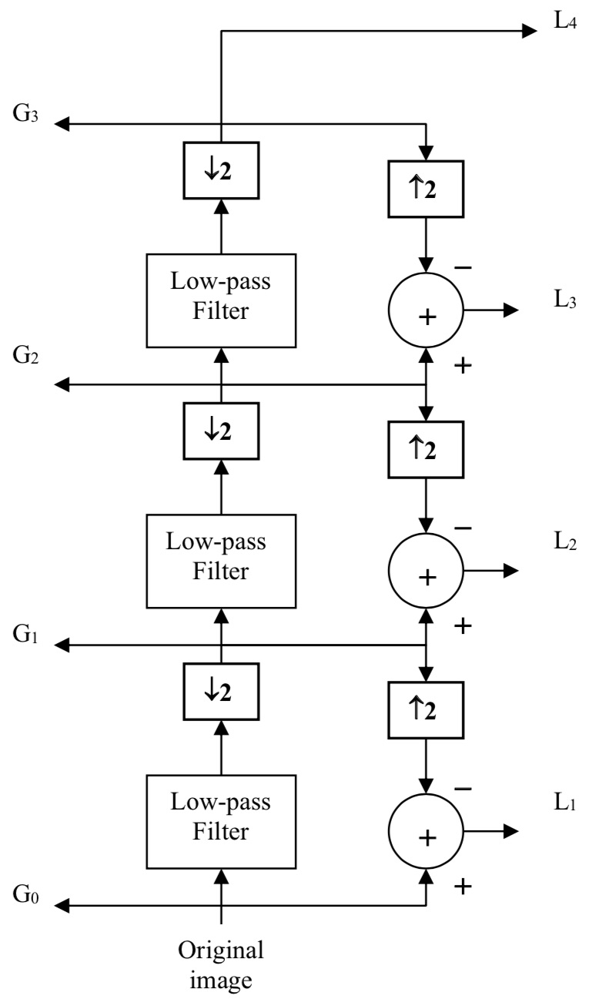

Let us analyze the scheme: The Gaussian images $G_n$ are now not only increasingly low-pass but also of smaller size ($512x512$, $256x256$, $128x128$ and $64x64$) because of the subsampling. This is the reason why this scheme is known as a pyramidal decomposition.

In order to compute the difference between $G_n$ and $G_{n-1}$ it is necessary to interpolate $G_n$. This interpolation is represented by the $\uparrow2$ symbol in the figure. The laplacian images $L_n$, as the Gaussian images are of decreasing size, creating a pyramid.

The interpolation process has to be taken into account for the reconstruction. From the picture above, it is easy to derive the following reconstruction process:
\begin{equation}
G_0 = interp(G_1) + L_1 = interp(interp(G_2) + L_2) + L_1 = \cdots
= interp(interp( \cdots interp(L_N) \cdots ) + L_2) + L_1 \tag{4}
\end{equation}

The following commands implement the pyramidal decomposition. We will use functions $pyramid\_reduce()$ and $pyramid\_expand$ from the $skimage.transform$ module to jointly perform the gaussian filtering + downsampling (in the case of $pyramid\_reduce()$) and upsampling + filtering (in the case of $pyramid\_expand()$):



In [32]:
from skimage.transform import pyramid_reduce, pyramid_expand

levels = 4

x = img
g = []
l = []
for i in range(levels):
  if i==0:
    g.append(x)
  else:
    cd = pyramid_reduce(g[i-1], channel_axis=None)
    cu = pyramid_expand(cd, channel_axis=None)
    g.append(cd)
    l.append(g[i-1] - cu)
l.append(g[i])

Let us visualize the complete decomposition, first the gaussian images $G_n$: 

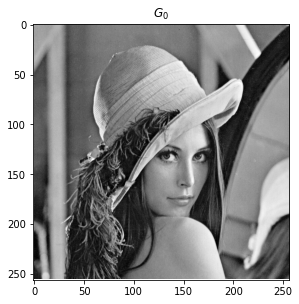

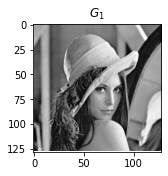

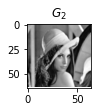

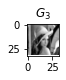

In [33]:
for i in range(levels):
  display_image(g[i],size=1,title='$G_{0:d}$'.format(i))

and then laplacian images $L_n$: 

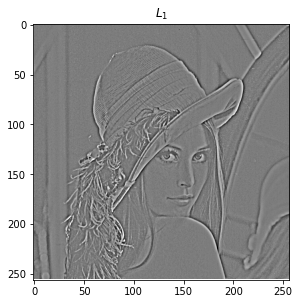

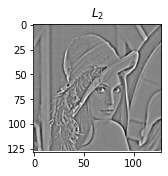

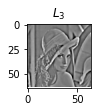

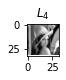

In [34]:
for i in range(levels):
  display_image(l[i],size=1,title='$L_{0:d}$'.format(i+1))

Let us perform the reconstruction process:

In [35]:
recons = []

for i in range(levels):
  if i==0:
    recons.append(l[levels-i-1])
  else:
    recons.append(pyramid_expand(recons[i-1]) + l[levels-i-1])


and visualize it:

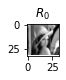

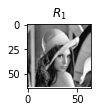

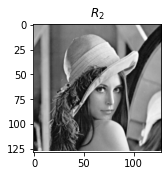

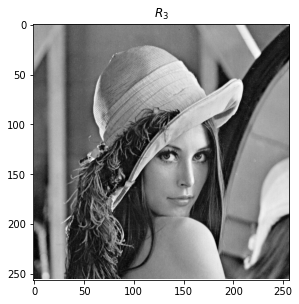

In [36]:
for i in range(levels):
  display_image(recons[i],size=1,title='$R_{0:d}$'.format(i))

Finally, let us compare the original and reconstructed images and compute the reconstruction error and the PSNR:

In [37]:
mse = np.mean(np.square(img - recons[-1]),axis=None)
psnr = -10*np.log10(mse+1e-100)
print('MSE = ', mse)
print('PSNR = ', psnr, 'dB')

MSE =  2.0571151139390031e-38
PSNR =  376.8674140497534 dB


The pyramidal decomposition has been used succesfully for different image processing algorithms since the early 80s. The main drawback of the pyramidal decomposition for compression is the number of generated pixels. In the limit, an image of size $NxN$ pixels is decomposed in: 
\begin{equation}
NxN + \frac{NxN}{4} + \frac{NxN}{16} + \frac{NxN}{64} + \cdots= NxN (\sum \frac{1}{4^n}) = \frac{4}{3} NxN = 1,333 NxN pixels
\end{equation} 

The wavelet decomposition also generates a multiscale decomposition of images but it does not imply any increase in the number of pixels in the transformation. This is what we are going to study in the next section. 

## 3 Multiscale analysis with wavelet




### 3.1 Wavelets families

The discrete wavelet decomposition can be computed with an iterated filter bank: 

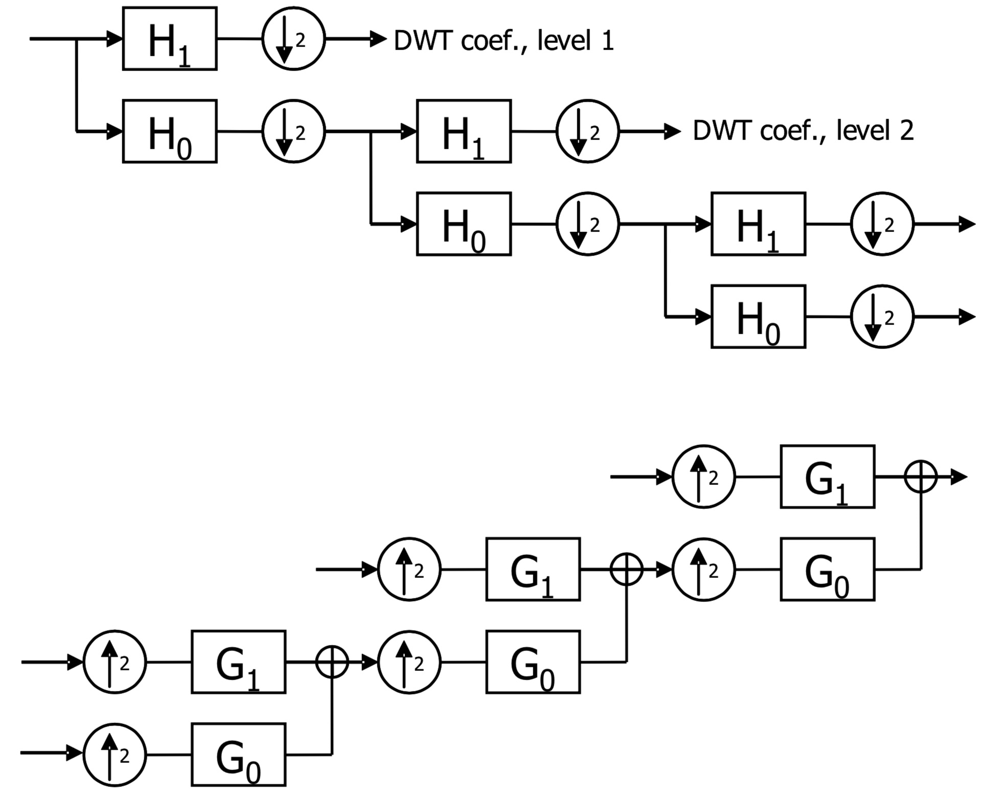

$H_0$ and $H_1$ are the analysis low-pass and high-pass filters whereas $G_0$ and $G_1$ are the synthesis low-pass and high-pass filters. We will use the python library pywavelets to generate the impulse response of these filters. 

We will start creating the filters for the Haar decomposition:


In [43]:
import pywt

filter_names = ['h0', 'h1', 'g0', 'g1']

def get_wavelet_filters(type):
  wavelet = pywt.Wavelet(type)
  filters = {}
  filters['h0'] = wavelet.dec_lo
  filters['h1'] = wavelet.dec_hi
  filters['g0'] = wavelet.rec_lo
  filters['g1'] = wavelet.rec_hi
  return filters,wavelet

def display_wavelet_filters_time(filters,filter_names):
  fig, axs = plt.subplots(2,2, gridspec_kw={'hspace': 0.4})
  for i in range(4):
    y = filters[filter_names[i]]
    x = np.arange(len(y))
    axs.flat[i].stem(x, y, use_line_collection=True)
    axs.flat[i].grid()
    axs.flat[i].set_title(filter_names[i] + '[n]')
    fig.show()

def display_wavelet_filters_freq(filters,filter_names,N):
  fig, axs = plt.subplots(2,2, gridspec_kw={'hspace': 0.4})
  for i in range(4):
    y = filters[filter_names[i]]
    Y = np.abs(np.fft.fftshift(np.fft.fft(y,n=N)))
    X = np.arange(N)/N - 0.5
    axs.flat[i].plot(X,Y)
    axs.flat[i].autoscale(enable=True, axis='x', tight=True)
    axs.flat[i].set_title('|' + filter_names[i].upper() + '(F)|')
    axs.flat[i].grid()
    fig.show()


filters_haar = get_wavelet_filters('haar')[0]

Let us visualize the impulse response of the filters:

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



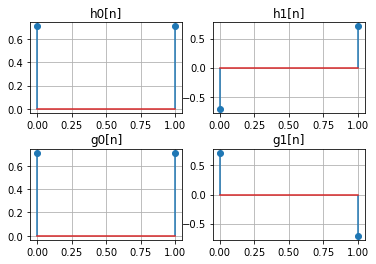

In [44]:
display_wavelet_filters_time(filters_haar,filter_names)

and the frequency response:

/tmp/ipykernel_4352/1067445580.py:34: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:34: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:34: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:34: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



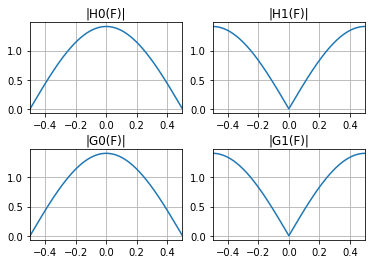

In [45]:
display_wavelet_filters_freq(filters_haar,filter_names,1024)

The synthesis filters are related to the analysis filters by the equation: $g_i[n] = h_i[L-1-n]$ (being $L$ the size in samples of the impulse response). The filters have linear phase and the high-pass filters are a modulated version of the low-pass filters.

We can check the orthogonality of the filter bank by comparing $h_0[n]$ ($h_1[n]$) and the time reversed version of $g_0[n]$ ($g_1[n]$). 

Moreover, the **symmetry in the impulse response** indicates that the filters have **linear phase**. 

In [46]:
# Compare h0[n] and g0[n]
print(filters_haar['h0'])
print(filters_haar['g0'])
print(filters_haar['h0'] - np.flip(filters_haar['g0']))

# Compare h1[n] and g1[n]
print(filters_haar['h1'])
print(filters_haar['g1'])
print(filters_haar['h1'] - np.flip(filters_haar['g1']))

[0.7071067811865476, 0.7071067811865476]
[0.7071067811865476, 0.7071067811865476]
[0. 0.]
[-0.7071067811865476, 0.7071067811865476]
[0.7071067811865476, -0.7071067811865476]
[0. 0.]


Let us repite the process but this time with Daubechies filters of length 6:

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:34: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:34: UserWarning:

Matplotlib is currently using module://matp

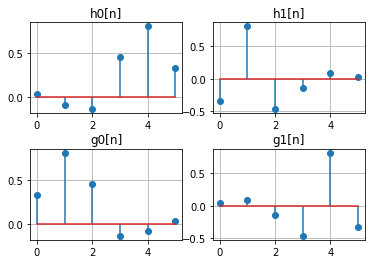

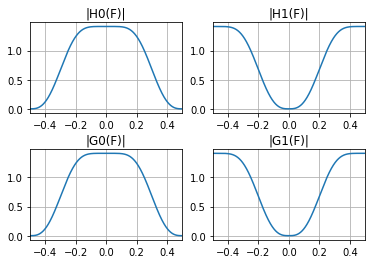

In [47]:
filters_db = get_wavelet_filters('db3')[0]
display_wavelet_filters_time(filters_db,filter_names)
display_wavelet_filters_freq(filters_db,filter_names,1024)

We can analyze the orthogonality:

In [50]:
# Compare h0[n] and g0[n]
print(filters_db['h0'])
print(filters_db['g0'])
print(filters_db['h0'] - np.flip(filters_db['g0']))

# Compare h1[n] and g1[n]
print(filters_db['h1'])
print(filters_db['g1'])
print(filters_db['h1'] - np.flip(filters_db['g1']))

[0.03522629188570953, -0.08544127388202666, -0.13501102001025458, 0.45987750211849154, 0.8068915093110925, 0.33267055295008263]
[0.33267055295008263, 0.8068915093110925, 0.45987750211849154, -0.13501102001025458, -0.08544127388202666, 0.03522629188570953]
[0. 0. 0. 0. 0. 0.]
[-0.33267055295008263, 0.8068915093110925, -0.45987750211849154, -0.13501102001025458, 0.08544127388202666, 0.03522629188570953]
[0.03522629188570953, 0.08544127388202666, -0.13501102001025458, -0.45987750211849154, 0.8068915093110925, -0.33267055295008263]
[0. 0. 0. 0. 0. 0.]


<font color='purple'>Q5. Are the Daubechies filters of length 6 orthogonal? Have they got a linear phase?</font>

---
<font color='red'>Q5. Answer: Orthogonality is demonstrated as the relationship h[n] = g[-n] holds for both filters, as we can verify with the code just above. To check for linear phase, we need to see if the filters are symmetric. In this case, the last 3 samples should be a mirror of the first 3. By examining h0, we can already see that this is not the case, so it is not a linear filter.

</font> 

Let us analyze now the case of biorthogonal filters:

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:22: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:34: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

/tmp/ipykernel_4352/1067445580.py:34: UserWarning:

Matplotlib is currently using module://matp

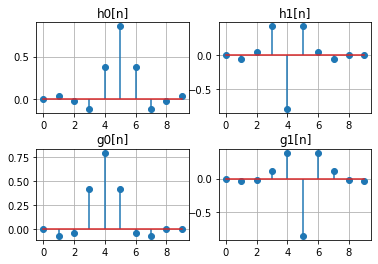

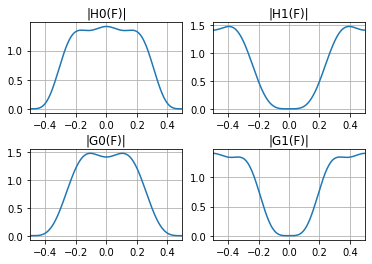

In [51]:
filters_bior = get_wavelet_filters('bior4.4')[0]
display_wavelet_filters_time(filters_bior,filter_names)
display_wavelet_filters_freq(filters_bior,filter_names,1024)

For the orthogonality, we can compare:

In [52]:
# Compare h0[n] and g0[n]
print(filters_bior['h0'])
print(filters_bior['g0'])
print(filters_bior['h0'] - np.flip(filters_bior['g0']))

# Compare h1[n] and g1[n]
print(filters_bior['h1'])
print(filters_bior['g1'])
print(filters_bior['h1'] - np.flip(filters_bior['g1']))

[0.0, 0.03782845550726404, -0.023849465019556843, -0.11062440441843718, 0.37740285561283066, 0.8526986790088938, 0.37740285561283066, -0.11062440441843718, -0.023849465019556843, 0.03782845550726404]
[0.0, -0.06453888262869706, -0.04068941760916406, 0.41809227322161724, 0.7884856164055829, 0.41809227322161724, -0.04068941760916406, -0.06453888262869706, 0.0, 0.0]
[ 0.          0.03782846  0.04068942 -0.06993499 -0.04068942  0.06421306
 -0.04068942 -0.06993499  0.04068942  0.03782846]
[-0.0, -0.06453888262869706, 0.04068941760916406, 0.41809227322161724, -0.7884856164055829, 0.41809227322161724, 0.04068941760916406, -0.06453888262869706, -0.0, 0.0]
[0.0, -0.03782845550726404, -0.023849465019556843, 0.11062440441843718, 0.37740285561283066, -0.8526986790088938, 0.37740285561283066, 0.11062440441843718, -0.023849465019556843, -0.03782845550726404]
[ 0.03782846 -0.04068942 -0.06993499  0.04068942  0.06421306  0.04068942
 -0.06993499 -0.04068942  0.03782846  0.        ]


<font color='purple'>Q6. Are the filters orthogonal? Have they got a linear phase?</font>

---
<font color='red'>Q6. Answer: The filter is not orthogonal since we find that the relationship h[n] = g[-n] is false for both pairs. Regarding linear phase, we need to check if the filters are symmetric about their midpoint. In this case, this property is indeed satisfied for all 4 filters, so the bi-orthogonal filters are linear.

</font> 

### 3.2 Wavelet decomposition

The wavelet decomposition is computed by an iterated filter bank. To process images, we first apply a horizontal filter bank and then a vertical filter bank: 

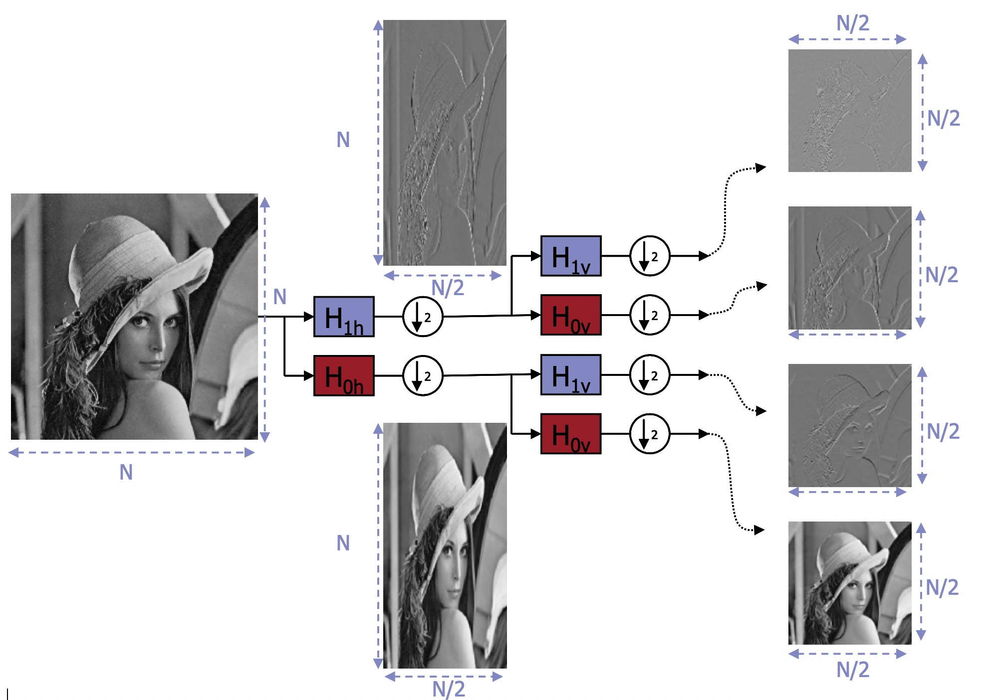

Compute the 'Haar' wavelet decomposition with four levels. We will use function wavedec2() from pywavelets module to compute the entire 2D decomposition:

In [53]:
levels = 4
coeffs_haar = pywt.wavedec2(img, 'haar',level=levels, mode='periodization')

And we will display the decomposition (normalizing the low pass band separately to better visualize the coefficients)

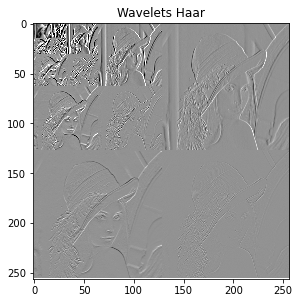

In [54]:
display_wavelet_dec(coeffs_haar,title='Wavelets Haar')

Let us compute that the reconstruction is correct:

MSE =  3.4352597537667796e-31
PSNR =  304.6404041861536 dB


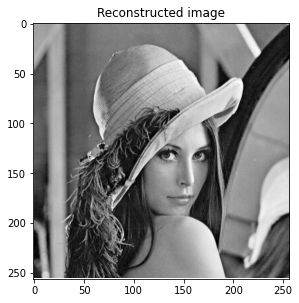

In [55]:
recons = pywt.waverec2(coeffs_haar,'haar', mode='periodization')
mse = np.mean(np.square(img - recons),axis=None)
psnr = -10*np.log10(mse+1e-100)
print('MSE = ', mse)
print('PSNR = ', psnr, 'dB')
display_image(recons,size=1,title='Reconstructed image')

Let us now compare the Haar decomposition result with the one obtained with biorthogonal filters:

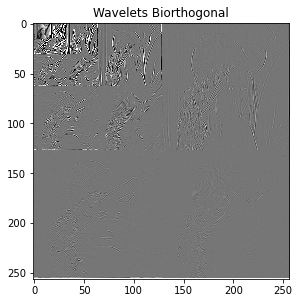

In [56]:
levels = 4
coeffs_bior = pywt.wavedec2(img, 'bior4.4',level=levels, mode='periodization')
display_wavelet_dec(coeffs_bior,title='Wavelets Biorthogonal')

MSE =  3.2095325907106746e-25
PSNR =  244.93558209980034 dB


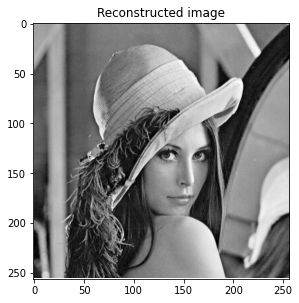

In [57]:
recons = pywt.waverec2(coeffs_bior,'bior4.4', mode='periodization')
mse = np.mean(np.square(img - recons),axis=None)
psnr = -10*np.log10(mse+1e-100)
print('MSE = ', mse)
print('PSNR = ', psnr, 'dB')
display_image(recons,size=1,title='Reconstructed image')

<font color='purple'>Q7. Is the Haar decomposition better or worse than the biorthogonal one? </font>

---
<font color='red'>Q7. Answer: We can see that the reconstruction is almost perfect in both cases, with an MSE practically equal to 0. However, the PSNR obtained using Haar is substantially higher, so we consider that the Haar decomposition is better.

</font> 

## 4 Image compression

### 4.1 Image compression with wavelets

In this section, a quantization / entropy coding approach known as SPIHT ("Set Partitioning In Hierarchical Trees") will be used. The JPEG2000 standard is using a similar technique to compress the information after the wavelet decomposition. 

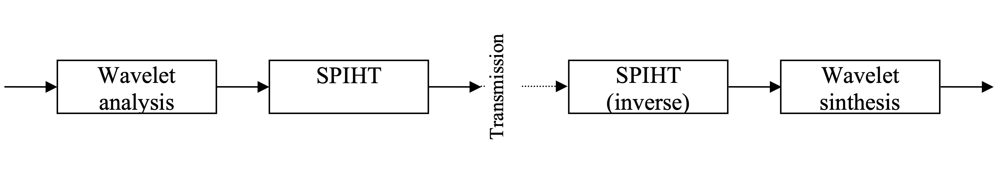

The SPIHT algorithm creates a bitstream ordering the information in such a way that the bits corresponding to the most important wavelet coefficients are at the beginning of the bitstream, whereas less important information appears at the end of the bitstream. Furthermore, the coefficients information is organized by bit planes: the most significant bits are transmitted first and the coefficient accuracy is progressively improved with less significant bits. Moreover, the SPIHT algorithm orders the coefficients as a function of their magnitude. Coefficients of high (low) magnitude are considered as more (less) important and will appear at the beginning (end) of the bitstream. Finally, "inter-scale" correlation is used: for example, the presence of a zero coefficient in a band at a given scale indicates that there is a high probability that the coefficients of the same band but at lower scales are also equal to zero. 


These configurations are known as zerotrees and are coded with a specific and unique symbol by the SPIHT. 

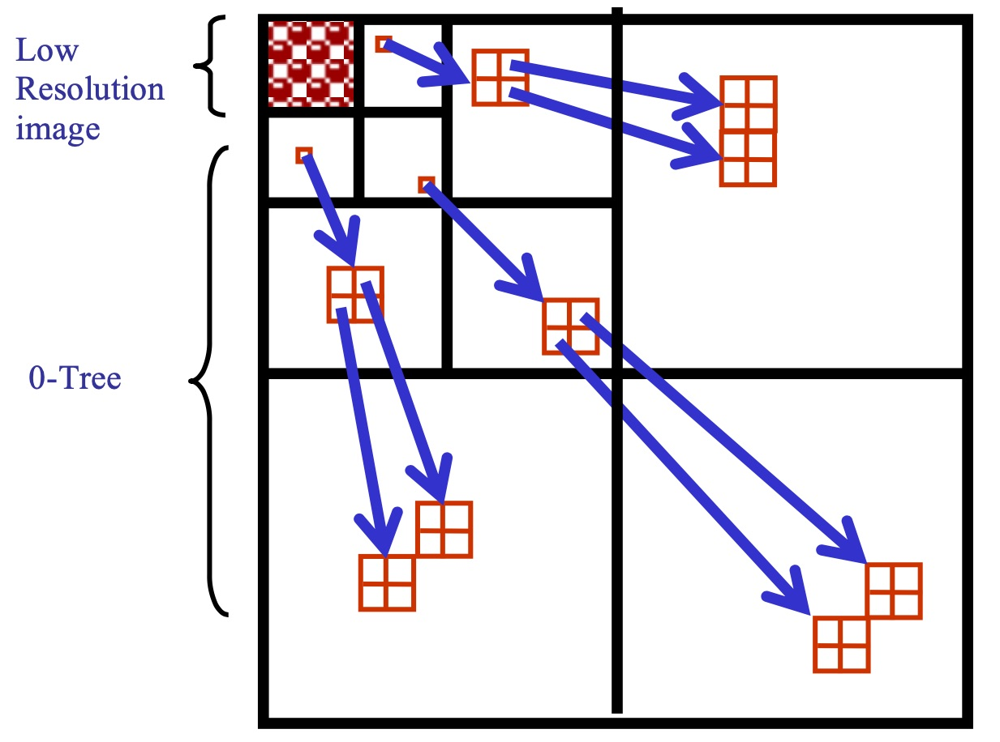


As a result of this information ordering process, the bistream is scalable: the compression factor can be chosen by simply cutting the bitstream at any point and we are sure to get the best possible representation (in the Mean Square Error sense) for this given number of bits.  

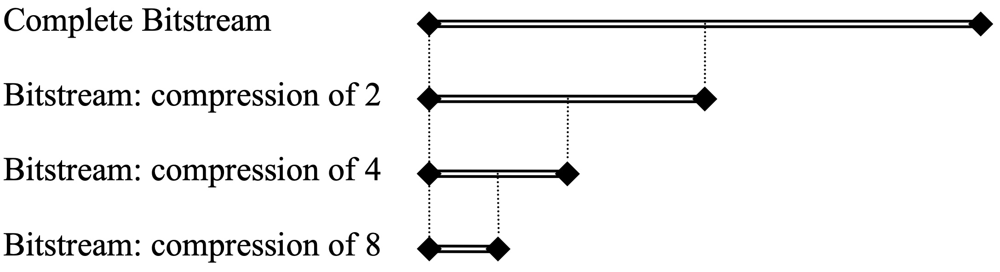

Execute the following code that contain the SPIHT implementation in python (You do NOT need to follow and understand this code, just the general concept of the algorithm explained above):

In [58]:
import functools
import operator
import numpy as np


def spiht_bitget(number, pos):
    return (number >> pos) & 1

def spiht_descendant(i, j, type, m):

    s = m.shape[0]
    S = []

    index = 0
    a = 0
    b = 0

    while 2*i < s and 2*j < s :

        a = i
        b = j

        mind = np.arange(2 * (a + 1) - 2, 2 * (a + np.exp2(index).astype(int)))
        nind = np.arange(2 * (b + 1) - 2, 2 * (b + np.exp2(index).astype(int)))

        # Check ranges
        mind = mind[mind<s]
        nind = nind[nind<s]

        S.append(m[np.ix_(mind,nind)].flatten())

        index = index + 1
        i = 2 * a
        j = 2 * b

    S2 = functools.reduce(operator.iconcat, S, [])

    if type == 1:
        S2 = np.delete(S2,np.arange(0,4),axis=0)

    r = np.abs(np.array(S2))

    r = np.max(r)

    return r


def spiht_encode(m, max_bits, level):

    block_size = m.size

    # Initialization
    bitctr = 0
    out = 2 * np.ones(max_bits - 14,int)
    n_max = np.floor(np.log2(np.abs(np.max(m))))
    Bits_Header = 0
    Bits_LSP = 0
    Bits_LIP = 0
    Bits_LIS = 0

    #   output bit stream header
    # image size, number of bit plane, wavelet decomposition level should be
    # written as bit stream header.
    out[0:3] = [m.shape[0], n_max, level]
    bitctr = bitctr + 24
    index = 3
    Bits_Header = Bits_Header + 24

    # Initialize LIP, LSP, LIS
    temp = []
    bandsize = np.exp2(np.log2(m.shape[0]) - level + 1).astype(int)

    temp1 = np.arange(bandsize)
    temp = np.tile(temp1, (bandsize, 1)).transpose()

    LIP = np.zeros((temp.size, 2), int)
    LIP[:, 0] = temp.flatten()
    LIP[:, 1] = temp.transpose().flatten()

    LIS = np.zeros((temp.size, 3), int)
    LIS[:, 0] = LIP[:, 0]
    LIS[:, 1] = LIP[:, 1]
    LIS[:, 2] = np.zeros(len(LIP[:, 0]))

    LSP = []

    pstart = 0
    pend = bandsize // 2
    for i in range(bandsize // 2):
        LIS = np.delete(LIS, np.array(range(pstart, pend)), axis=0)
        pdel = pend - pstart;
        pstart = pstart + bandsize - pdel
        pend = pend + bandsize - pdel

    n = n_max;

    #  coding
    while bitctr < max_bits:

        # Sorting Pass
        LIPtemp = LIP
        temp = 0

        for i in range(LIPtemp.shape[0]):

            if (bitctr + 1) >= max_bits:
                if (bitctr < max_bits):
                    out = np.delete(out, -1)
                return out

            if np.abs(m[LIPtemp[i, 0], LIPtemp[i, 1]]) >= np.exp2(n):  # 1: positive; 0: negative
                out[index] = 1
                bitctr = bitctr + 1
                index = index + 1
                Bits_LIP = Bits_LIP + 1
                sgn = m[LIPtemp[i, 0], LIPtemp[i, 1]] >= 0
                out[index] = sgn
                bitctr = bitctr + 1
                index = index + 1
                Bits_LIP = Bits_LIP + 1

                LSP.append(LIPtemp[i, :].tolist())
                LIP = np.delete(LIP, temp, axis=0)
                temp = temp - 1
            else:
                out[index] = 0
                bitctr = bitctr + 1
                index = index + 1
                Bits_LIP = Bits_LIP + 1

            temp = temp + 1

        LIStemp = LIS
        temp = 0
        i = 0
        while i < LIStemp.shape[0]:

            if LIStemp[i,2] == 0:
                if bitctr >= max_bits:
                    return out
                max_d = spiht_descendant(LIStemp[i,0], LIStemp[i,1], LIStemp[i,2], m)

                if max_d >= np.exp2(n):
                    out[index] = 1
                    bitctr = bitctr + 1
                    index = index + 1
                    Bits_LIS = Bits_LIS + 1
                    x = LIStemp[i,0]
                    y = LIStemp[i,1]

                    if (bitctr + 1) >= max_bits:
                        if bitctr < max_bits:
                            out = np.delete(out, -1)
                        return out

                    if np.abs(m[2*x,2*y]) >= np.exp2(n):
                        LSP.append([2*x,2*y])
                        out[index] = 1
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                        sgn = m[2*x,2*y] >= 0
                        out[index] = sgn
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                    else:
                        out[index] = 0
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                        LIP = np.vstack((LIP,[2*x,2*y]))

                    if (bitctr + 1) >= max_bits:
                        if bitctr < max_bits :
                            out = np.delete(out, -1)
                        return out

                    if np.abs(m[2*x,2*y + 1]) >= np.exp2(n):
                        LSP.append([2*x, 2*y + 1])
                        out[index] = 1
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                        sgn = m[2*x,2*y + 1] >= 0
                        out[index] = sgn
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                    else:
                        out[index] = 0
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                        LIP = np.vstack((LIP,[2*x,2*y + 1]))

                    if (bitctr + 1) >= max_bits:
                        if bitctr < max_bits:
                            out = np.delete(out, -1)
                        return out

                    if np.abs(m[2*x + 1, 2*y]) >= np.exp2(n):
                        LSP.append([2*x + 1, 2*y])
                        out[index] = 1
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                        sgn = m[2*x + 1, 2*y] >= 0
                        out[index] = sgn
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                    else:
                        out[index] = 0
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                        LIP = np.vstack((LIP, [2*x + 1, 2*y]))

                    if (bitctr + 1) >= max_bits:
                        if bitctr < max_bits:
                            out = np.delete(out, -1)
                        return out

                    if np.abs(m[2*x + 1, 2*y + 1]) >= np.exp2(n):
                        LSP.append([2*x + 1, 2*y + 1])
                        out[index] = 1
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                        sgn = m[2*x + 1,2*y + 1] >= 0
                        out[index]= sgn
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                    else:
                        out[index] = 0
                        bitctr = bitctr + 1
                        index = index + 1
                        Bits_LIS = Bits_LIS + 1
                        LIP = np.vstack((LIP, [2*x + 1, 2*y + 1]))

                    if (4*x+2 < m.shape[0]) and (4*y+2 < m.shape[1]):
                        LIS = np.vstack((LIS, [LIStemp[i,0],LIStemp[i,1],1]))
                        LIStemp = np.vstack((LIStemp, [LIStemp[i, 0], LIStemp[i, 1], 1]))
                    LIS = np.delete(LIS, temp, axis=0)
                    temp = temp - 1

                else:
                    out[index] = 0
                    bitctr = bitctr + 1
                    index = index + 1
                    Bits_LIS = Bits_LIS + 1

            else:
                if bitctr >= max_bits:
                    return out

                max_d = spiht_descendant(LIStemp[i,0], LIStemp[i,1], LIStemp[i,2], m)

                if max_d >= np.exp2(n):
                    out[index] = 1
                    bitctr = bitctr + 1
                    index = index + 1
                    x = LIStemp[i,0]
                    y = LIStemp[i,1]
                    LIS = np.vstack((LIS,[2*x    , 2*y    , 0]))
                    LIS = np.vstack((LIS,[2*x    , 2*y + 1, 0]))
                    LIS = np.vstack((LIS,[2*x + 1, 2*y    , 0]))
                    LIS = np.vstack((LIS,[2*x + 1, 2*y + 1, 0]))
                    LIStemp = np.vstack((LIStemp,[2*x    , 2*y    , 0]))
                    LIStemp = np.vstack((LIStemp,[2*x    , 2*y + 1, 0]))
                    LIStemp = np.vstack((LIStemp,[2*x + 1, 2*y    , 0]))
                    LIStemp = np.vstack((LIStemp,[2*x + 1, 2*y + 1,0]))
                    LIS = np.delete(LIS, temp, axis=0)
                    temp = temp - 1
                else:
                    out[index] = 0
                    bitctr = bitctr + 1
                    index = index + 1
                    Bits_LIS = Bits_LIS + 1

            i = i + 1
            temp = temp + 1

        # Refinement Pass
        temp = 0
        value = np.floor(np.abs(np.exp2(n_max - n + 1) * m[LSP[temp][0],LSP[temp][1]])).astype(int)

        while (value >= np.exp2(n_max + 2) and (temp < len(LSP))):

            if bitctr >= max_bits:
                return out

            s = spiht_bitget(value, int(n_max + 1))
            out[index] = s
            bitctr = bitctr + 1
            index = index + 1
            Bits_LSP = Bits_LSP + 1
            temp = temp + 1
            if temp < len(LSP):
                value = np.floor(np.abs(np.exp2(n_max - n + 1) * m[LSP[temp][0],LSP[temp][1]])).astype(int)

        n = n - 1

    return out



def spiht_decode(bits):

    # Initialization
    m = np.zeros((bits[0],bits[0]),np.double)
    n_max = bits[1]
    level = bits[2]
    ctr = 3

    # Initialize LIP, LSP, LIS
    temp = []
    bandsize = np.exp2(np.log2(bits[0]) - level + 1).astype(int)

    temp1 = np.arange(bandsize)
    temp = np.tile(temp1, (bandsize, 1)).transpose()

    LIP = np.zeros((temp.size, 2), int)
    LIP[:, 0] = temp.flatten()
    LIP[:, 1] = temp.transpose().flatten()

    LIS = np.zeros((temp.size, 3), int)
    LIS[:, 0] = LIP[:, 0]
    LIS[:, 1] = LIP[:, 1]
    LIS[:, 2] = np.zeros(len(LIP[:, 0]))

    LSP = []

    pstart = 0
    pend = bandsize // 2
    for i in range(bandsize // 2):
        LIS = np.delete(LIS, np.array(range(pstart, pend)), axis=0)
        pdel = pend - pstart;
        pstart = pstart + bandsize - pdel
        pend = pend + bandsize - pdel

    #  coding
    n = n_max

    while ctr < bits.shape[0]:

        # Sorting Pass
        LIPtemp = LIP
        temp = 0

        for i in range(LIPtemp.shape[0]):

            if ctr >= bits.shape[0] - 1: # addtl cond., prevents counter overflow
                return m

            if bits[ctr] == 1:
                ctr = ctr + 1
                if bits[ctr] > 0:
                    m[LIPtemp[i,0], LIPtemp[i,1]] = np.exp2(n) + np.exp2(n - 1)
                else:
                    m[LIPtemp[i,0], LIPtemp[i,1]] = -1*np.exp2(n) - np.exp2(n - 1)

                LSP.append(LIPtemp[i, :].tolist())
                LIP = np.delete(LIP, temp, axis=0)
                temp = temp - 1

            ctr = ctr + 1
            temp = temp + 1


        LIStemp = LIS
        temp = 0
        i = 0
        while i < LIStemp.shape[0]:

            if ctr >= bits.shape[0]:
                return m

            if LIStemp[i,2] == 0:

                if bits[ctr] == 1:
                    ctr = ctr + 1
                    x = LIStemp[i,0]
                    y = LIStemp[i,1]

                    if ctr >= bits.shape[0] - 1:  # addtl cond., prevents counter overflow
                        return m

                    if bits[ctr] == 1:
                        LSP.append([2*x,2*y])
                        ctr = ctr + 1
                        if bits[ctr] == 1:
                            m[2*x, 2*y] = np.exp2(n) + np.exp2(n - 1)
                        else:
                            m[2*x, 2*y] = -1*np.exp2(n) - np.exp2(n - 1);
                        ctr = ctr + 1
                    else:
                        LIP = np.vstack((LIP,[2*x,2*y]))
                        ctr = ctr + 1

                    if ctr >= bits.shape[0] - 1:  # addtl cond., prevents counter overflow
                        return m

                    if bits[ctr] == 1:
                        ctr = ctr + 1
                        LSP.append([2*x, 2*y + 1])
                        if bits[ctr] == 1:
                            m[2*x, 2*y+1] = np.exp2(n) + np.exp2(n - 1)
                        else:
                            m[2*x, 2*y+1] = -1*np.exp2(n) - np.exp2(n - 1)
                        ctr = ctr + 1
                    else:
                        LIP = np.vstack((LIP,[2*x, 2*y + 1]))
                        ctr = ctr + 1

                    if ctr >= bits.shape[0] - 1:  # addtl cond., prevents counter overflow
                        return m

                    if bits[ctr] == 1:
                        ctr = ctr + 1
                        LSP.append([2*x + 1, 2*y])
                        if bits[ctr] == 1:
                            m[2*x + 1, 2*y] = np.exp2(n) + np.exp2(n - 1)
                        else:
                            m[2*x + 1, 2*y] = -1*np.exp2(n) - np.exp2(n - 1)
                        ctr = ctr + 1
                    else:
                        LIP = np.vstack((LIP,[2*x + 1, 2*y]))
                        ctr = ctr + 1

                    if ctr >= bits.shape[0] - 1:  # addtl cond., prevents counter overflow
                        return m

                    if bits[ctr] == 1:
                        ctr = ctr + 1
                        LSP.append([2*x + 1, 2*y + 1])
                        if bits[ctr] == 1:
                            m[2*x + 1, 2*y + 1] = np.exp2(n) + np.exp2(n-1)
                        else:
                            m[2*x + 1, 2*y + 1] = -1*np.exp2(n)  - np.exp2(n-1)
                        ctr = ctr + 1
                    else:
                        LIP = np.vstack((LIP,[2*x + 1, 2*y + 1]))
                        ctr = ctr + 1

                    if (4*x+2 < m.shape[0]) and (4*y+2 < m.shape[1]):
                        LIS = np.vstack((LIS, [LIStemp[i,0],LIStemp[i,1],1]))
                        LIStemp = np.vstack((LIStemp, [LIStemp[i, 0], LIStemp[i, 1], 1]))
                    LIS = np.delete(LIS, temp, axis=0)
                    temp = temp - 1

                else:
                    ctr = ctr + 1

            else:
                if bits[ctr] == 1:

                    x = LIStemp[i,0]
                    y = LIStemp[i,1]
                    LIS = np.vstack((LIS,[2*x    , 2*y    , 0]))
                    LIS = np.vstack((LIS,[2*x    , 2*y + 1, 0]))
                    LIS = np.vstack((LIS,[2*x + 1, 2*y    , 0]))
                    LIS = np.vstack((LIS,[2*x + 1, 2*y + 1, 0]))
                    LIStemp = np.vstack((LIStemp,[2*x    , 2*y    , 0]))
                    LIStemp = np.vstack((LIStemp,[2*x    , 2*y + 1, 0]))
                    LIStemp = np.vstack((LIStemp,[2*x + 1, 2*y    , 0]))
                    LIStemp = np.vstack((LIStemp,[2*x + 1, 2*y + 1,0]))
                    LIS = np.delete(LIS, temp, axis=0)
                    temp = temp - 1

                ctr = ctr + 1

            i = i + 1
            temp = temp + 1

        # Refinement Pass
        temp = 0
        value = m[LSP[temp][0], LSP[temp][1]]

        while (np.abs(value) >= np.exp2(n + 1) and (temp < len(LSP))):

            if ctr >= bits.shape[0] - 1:  # addtl cond., prevents counter overflow
                return m

            value = value + np.float_power(-1, bits[ctr] + 1) * np.float_power(2,n - 1) * np.sign(m[LSP[temp][0], LSP[temp][1]])
            m[LSP[temp][0], LSP[temp][1]] = value
            ctr = ctr + 1
            temp = temp + 1
            if temp < len(LSP):
                value = m[LSP[temp][0], LSP[temp][1]]

        n = n - 1

    return m


Let us first compute a bitstream for a compression equal to 0.8 bpp (bits per pixel), that is a compression factor of 10. We will also substract the mean of the image so the resulting dynamic range is between $[-0.5,0.5]$ as expected by the SPIHT encoder/decoder implementation:

In [59]:
# Make sure image go between [-0.5,0.5]
img_mean = np.mean(img)
imgm = img - img_mean

print('Image min value = ', np.min(imgm),'; Image max value = ', np.max(imgm))
print('Image shape = ', imgm.shape)

Image min value =  -0.37773271394456515 ; Image max value =  0.428965618087047
Image shape =  (256, 256)


Compute the wavelet decomposition of the image with Haar filters:

In [60]:
# Wavelet decomposition
level = 4
coeffs_haar = pywt.wavedec2(imgm, 'haar',level=level)
wd,slices = pywt.coeffs_to_array(coeffs_haar)

Compress the wavelet coefficients with the SPIHT algorithm:

In [61]:
bit_per_pixel = 0.8
max_bits = np.round(img.size*bit_per_pixel).astype(int)
bits = spiht_encode(wd, max_bits, level)

Starting from this bitstream, we can generate all bitstream corresponding to a compression lower than 0.8 bpp. But before modifying the bitstream, let us decompress the image. 

Decode the bistream with the SPIHT algorithm.

In [62]:
wd_dec = spiht_decode(bits)
coeffs_haar_rec = pywt.array_to_coeffs(wd_dec, slices, output_format='wavedec2')

Visualize the decoded coefficients and compare them with original wavelet coefficients:

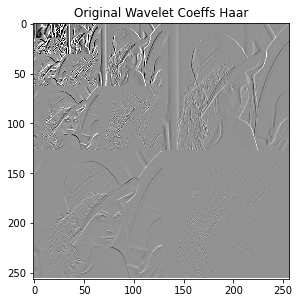

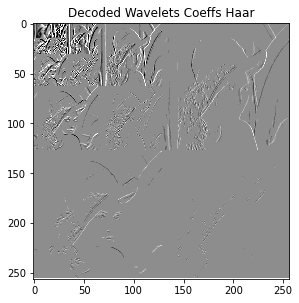

In [63]:
display_wavelet_dec(coeffs_haar,title='Original Wavelet Coeffs Haar')
display_wavelet_dec(coeffs_haar_rec,title='Decoded Wavelets Coeffs Haar')

Finally, one can synthesize an image from the decoded coefficients and compare the reconstructed image with the original and compute the peak signal to noise ratio between them.

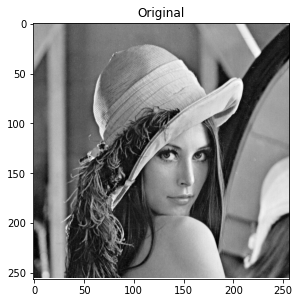

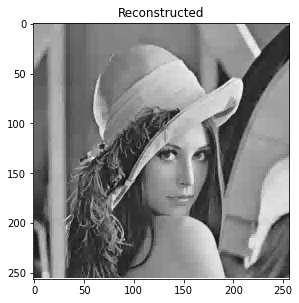

PSNR =  32.91761585912023 dB


In [64]:
imgm_rec = pywt.waverec2(coeffs_haar_rec, 'haar')
img_rec = imgm_rec + img_mean

display_image(img,size=1,title='Original')
display_image(img_rec,size=1,title='Reconstructed')

mse = np.mean(np.square(img - img_rec),axis=None)
psnr = -10*np.log10(mse)
print('PSNR = ', psnr, 'dB')


<font color='purple'>Q8. What kind of distortion can be observed? What is your assessment of this result?</font>

---
<font color='red'>Q8. Answer: The observed distortion causes the image to be composed of visible squares with homogeneous pixel values. Since all pixels within each square have the same value, there is a very sharp contrast between squares with different values, leading to the appearance of a pixelated image. Despite the substantial loss of quality, we cannot ignore that we are compressing the image information by a factor of 10, and the loss of quality in comparison is not as significant.

</font> 

Let us reduce the bitstream by half and try to see the reconstructed image:


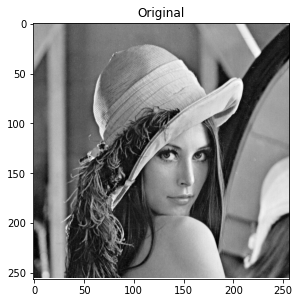

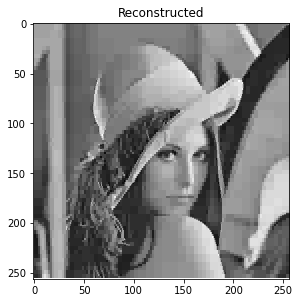

PSNR =  28.329950346458354 dB


In [65]:
bits_half = bits[0:bits.shape[0]//2]

wd_dec = spiht_decode(bits_half)
coeffs_haar_rec = pywt.array_to_coeffs(wd_dec, slices, output_format='wavedec2')

imgm_rec = pywt.waverec2(coeffs_haar_rec, 'haar')
img_rec = imgm_rec + img_mean

display_image(img,size=1,title='Original')
display_image(img_rec,size=1,title='Reconstructed')

mse = np.mean(np.square(img - img_rec),axis=None)
psnr = -10*np.log10(mse)
print('PSNR = ', psnr, 'dB')

Now choose the number of bit per pixel so that the distortion is almost not noticeable. Note that for high number of bits per pixels, as the bitstream is longer, the computational load will be also higher: 



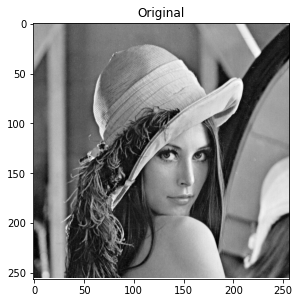

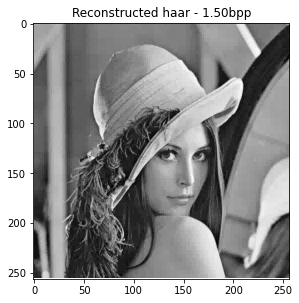

PSNR =  38.747232159883396 dB


In [66]:
# Wavelet decomposition
wname = 'haar'
coeffs = pywt.wavedec2(imgm, wname, level=level)
wd,slices = pywt.coeffs_to_array(coeffs)

# SPITH encode
bit_per_pixel = 1.5
max_bits = np.round(img.size*bit_per_pixel).astype(int)
bits = spiht_encode(wd, max_bits, level)

# SPITH decode
wd_dec = spiht_decode(bits)

# Wavelet reconstruction
coeffs_rec = pywt.array_to_coeffs(wd_dec, slices, output_format='wavedec2')
imgm_rec = pywt.waverec2(coeffs_rec, wname)
img_rec = imgm_rec + img_mean

# Display
display_image(img,size=1,title='Original')
display_image(img_rec,size=1,title='Reconstructed {0:s} - {1:0.2f}bpp'.format(wname,bit_per_pixel))
mse = np.mean(np.square(img - img_rec),axis=None)
psnr = -10*np.log10(mse)
print('PSNR = ', psnr, 'dB')

<font color='purple'>Q9. What is the limit of the number of bits per pixel for your image so that the distortion is almost not noticeable? What is the corresponding PSNR?</font>


---
<font color='red'>Q9. Answer: We have determined the limit to be between 1.4 and 1.6 bits per pixel, with which we obtain a PSNR = 38.74.

</font> 

Perform now a decomposition with biorthogonal filters. Choose the number of bit per pixel so that the distortion is almost not noticeable: 

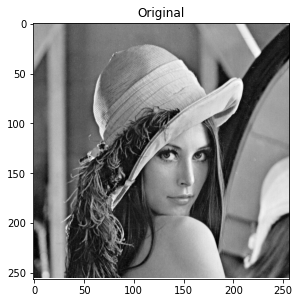

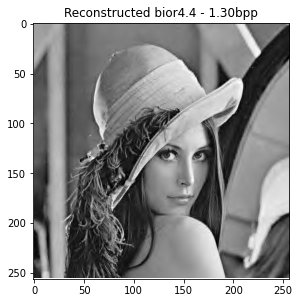

PSNR =  38.53699295669394 dB


In [67]:
# Wavelet decomposition
wname = 'bior4.4'
coeffs = pywt.wavedec2(imgm, wname,level=level)
wd,slices = pywt.coeffs_to_array(coeffs)

# SPITH encode
bit_per_pixel = 1.3
max_bits = np.round(img.size*bit_per_pixel).astype(int)
bits = spiht_encode(wd, max_bits, level)

# SPITH decode
wd_dec = spiht_decode(bits)

# Wavelet reconstruction
coeffs_rec = pywt.array_to_coeffs(wd_dec, slices, output_format='wavedec2')
imgm_rec = pywt.waverec2(coeffs_rec, wname)
img_rec = imgm_rec + img_mean

# Display
display_image(img,size=1,title='Original')
display_image(img_rec,size=1,title='Reconstructed {0:s} - {1:0.2f}bpp'.format(wname,bit_per_pixel))
mse = np.mean(np.square(img - img_rec),axis=None)
psnr = -10*np.log10(mse)
print('PSNR = ', psnr, 'dB')

<font color='purple'>Q10. What is the limit of the number of bit per pixel for your image for the biorthogonal wavelet so that the distortion is almost not noticeable? What is the corresponding PSNR? Does it correspond to what you expected? </font>


---
<font color='red'>Q10. Answer: 1.3 and a PSNR = 38.53. We see that to achieve a similar PSNR to the Haar decomposition, we need fewer bits per pixel.
</font> 

<font color='purple'>Q11. How would you describe the difference in terms of distortion between the compression done with Haar and with the biorthogonal wavelets?</font>


---
<font color='red'>Q11. Answer: While the decomposition with Haar filters exhibits block distortion (pixelation), the one decomposed with bi-orthogonal filters presents blurred contours, causing areas with high contrast (in this case, feathers or lips) to be poorly defined, while areas with low contrast practically show no distortion.

</font> 

In the following figure, the PSNR as a function of the number of bit per pixel for three filters (Haar, Daubechies of length 5 and biorthogonal) and a specific image has been computed.  




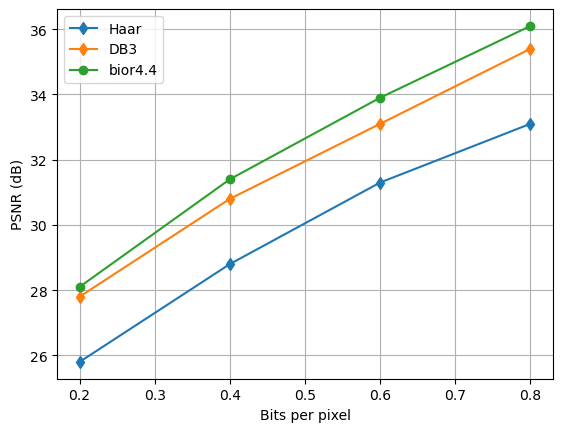

In [53]:
fig_haar = [25.8,28.8,31.3,33.1]
fig_db3 = [27.8,30.8,33.1,35.4]
fig_bior = [28.1,31.4,33.9,36.1]
bpp = [0.2,0.4,0.6,0.8]

plt.plot(bpp,fig_haar,'-d')
plt.plot(bpp,fig_db3,'-d')
plt.plot(bpp,fig_bior,'-o')
plt.legend(('Haar','DB3','bior4.4'))
plt.xlabel('Bits per pixel')
plt.ylabel('PSNR (dB)')
plt.grid()
plt.show()

<font color='purple'>Q12. What conclusions can be drawn from the figure?</font>


---
<font color='red'>Q12. Answer: We can see that the bi-orthogonal filter is better, as it has a higher PSNR than the others for any value of bits per pixel, as we had observed experimentally in the previous exercise.

</font> 